# Disseration Experiment 5g
# Generate ANCHOR Output (Credit Default) November Twenty Two¶
Ciaran Finnegan November 2023

# Import Libraries + Custom Functions

## Import Libraries

In [1]:
# Import libs
import numpy as np
import pandas as pd
import xgboost as xgb
import lightgbm as lgb
from sklearn.ensemble import RandomForestRegressor,RandomForestClassifier
import shap
import random

# Display libraries
from IPython.display import display, HTML
from prettytable import PrettyTable

# Import necessary libraries for ANN model building
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam


# Import necessary libraries for LIME calculations
import lime
import lime.lime_tabular


# Import necessary library for ANCHOR explainer
import alibi
from alibi.explainers import AnchorTabular
from anchor import anchor_tabular


# Libraries required for metrics calculations
from scipy.spatial import distance
from sklearn.cluster import KMeans

from sklearn.preprocessing import LabelEncoder
import warnings

# Compute additional evaluation metrics
import sklearn.metrics
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.utils import resample
from sklearn.metrics import precision_score, recall_score, f1_score


# Classifier training (not used for explainability)
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV


# Additional display libraires
import contextlib
import os
import sys
from contextlib import contextmanager

## Custom Functions

Dataset Visualisations

In [2]:
%run ./DS_Visualisation_Functions.ipynb

Metrics

In [3]:
%run ./XAI_Metrics_Functions.ipynb

Function 'example_function' executed in 2.0019 seconds
Result: Result, Execution Time: 2.0018815994262695 seconds


Model Evaluation Functions

In [4]:
%run ./DS_Model_Build_Evaluation_Functions.ipynb

# Data Visualisation and Exploration

## Import Data

In [5]:
ds_file_to_load = 'credit_default_data.csv'
df = pd.read_csv(ds_file_to_load)

## Data Exploration

### Dataset Structure

In [6]:
# Display the first few rows of the dataset to understand its structure
# This function is read from the file of custom display functions
styled_dataframe(df.head())

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default
0,20000,2,2,1,24,2,2,-1,-1,-2,-2,3913,3102,689,0,0,0,0,689,0,0,0,0,1
1,120000,2,2,2,26,-1,2,0,0,0,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,90000,2,2,2,34,0,0,0,0,0,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,50000,2,2,1,37,0,0,0,0,0,0,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,50000,1,2,1,57,-1,0,-1,0,0,0,8617,5670,35835,20940,19146,19131,2000,36681,10000,9000,689,679,0


In [7]:
# Reset default Pandas display options
pd.reset_option('display.max_columns')
pd.reset_option('display.expand_frame_repr')
pd.reset_option('display.max_colwidth')
# Display the dataframe
display(df.head())

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default
0,20000,2,2,1,24,2,2,-1,-1,-2,...,0,0,0,0,689,0,0,0,0,1
1,120000,2,2,2,26,-1,2,0,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,90000,2,2,2,34,0,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,50000,2,2,1,37,0,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,50000,1,2,1,57,-1,0,-1,0,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0


### Generate Visualizations

In [8]:
# Set up the target and features to be visualised

sTarget_feature = 'default'
sFeature_analysis_1 = 'LIMIT_BAL'
sFeature_analysis_2 = 'AGE'
sFeature_analysis_3 = 'SEX'
sFeature3_ticklabel1 = 'Male'
sFeature3_ticklabel2 = 'Female'

#### Generate Visualizations to better understand the data distribution and relationships between features.

##### Bar and Box Plot Visualisations

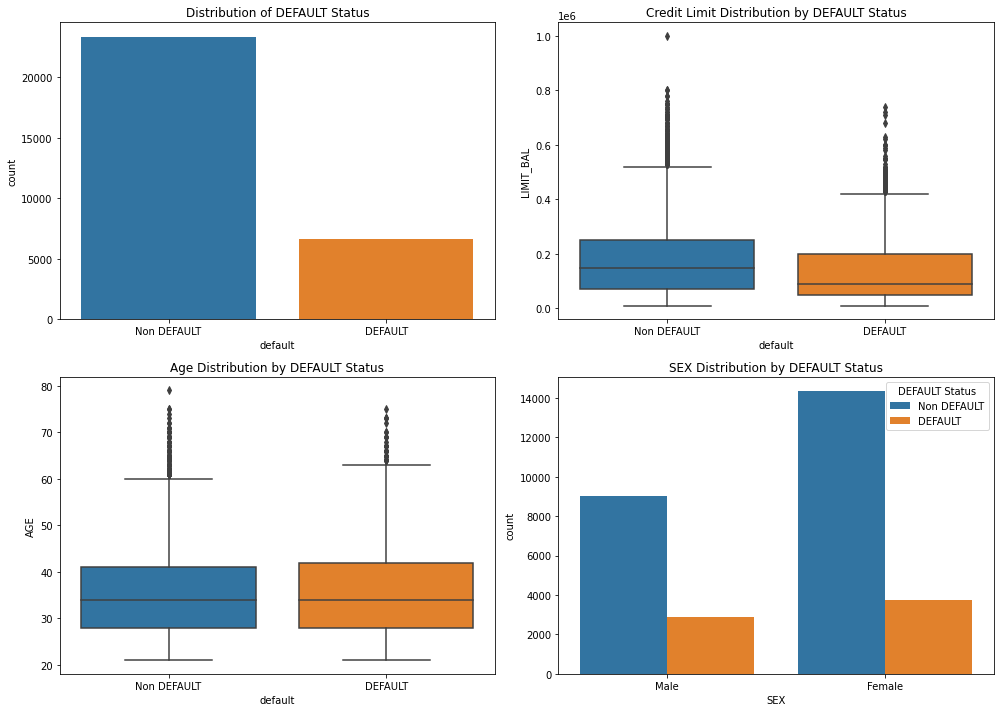

In [9]:
generate_box_plots(df, sTarget_feature, 
                       sFeature_analysis_1, 
                       sFeature_analysis_2, 
                       sFeature_analysis_3,
                       sFeature3_ticklabel1, 
                       sFeature3_ticklabel2)

#### Heatmap Visualisation

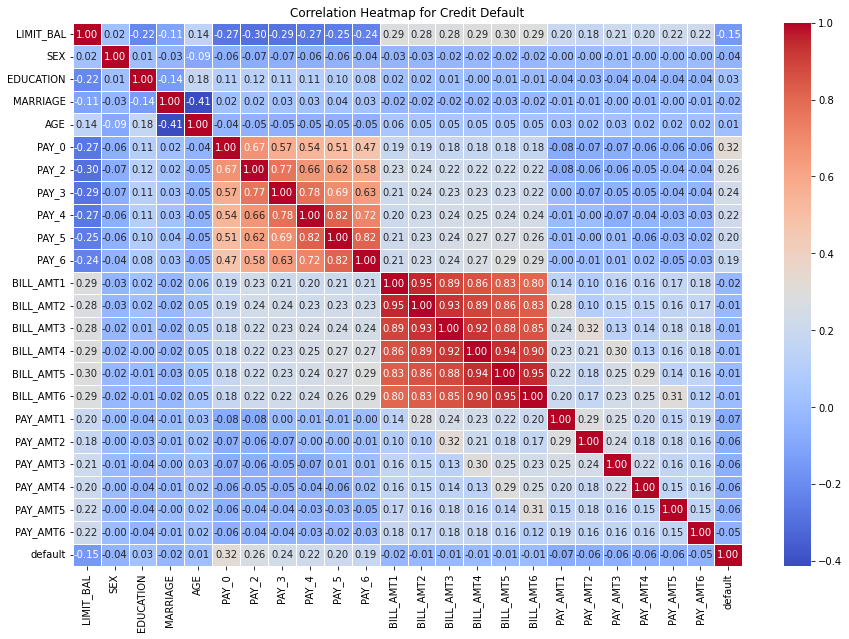

In [10]:
generate_heatmap(df, "Credit Default")

#### Distributions

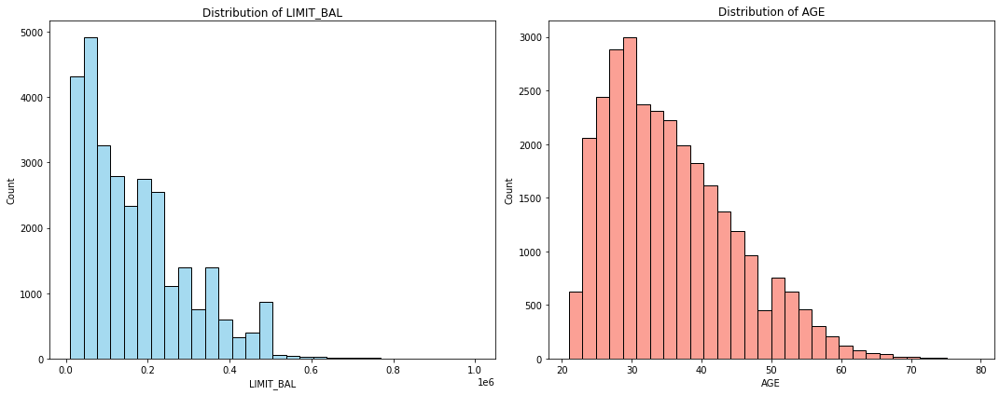

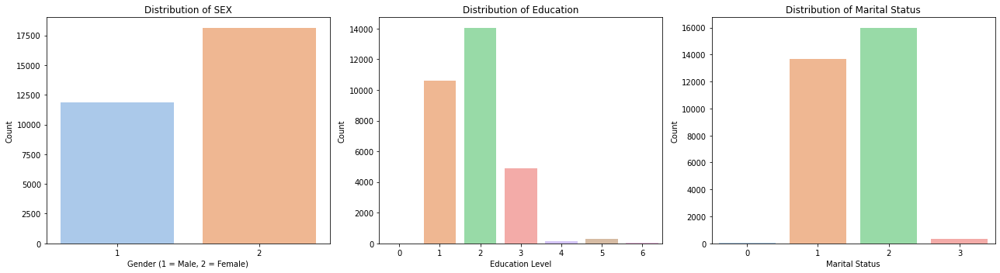

In [11]:
generate_distributions(df, 
                       sFeature_analysis_1, 
                       sFeature_analysis_2, 
                       sFeature_analysis_3)

# Feature Engineering

## Check for Missing Data

In [12]:
# Determine the threshold for missing values
threshold = 0.75 * len(df)

# Identify columns with missing values greater than the threshold
missing_columns = df.columns[df.isnull().sum() > threshold]

# Print the columns with more than 75% missing values
print("Columns with more than 75% missing values:", missing_columns)

# Drop columns with missing values greater than the threshold
df = df.drop(columns=missing_columns)

# Save or continue processing with columns removed that had high volumes of missing data


Columns with more than 75% missing values: Index([], dtype='object')


In [13]:
# Display the first few rows of the dataset to re-check structure once any columns with 
# significant amounts of missing data have been removed
df.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default
0,20000,2,2,1,24,2,2,-1,-1,-2,...,0,0,0,0,689,0,0,0,0,1
1,120000,2,2,2,26,-1,2,0,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,90000,2,2,2,34,0,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,50000,2,2,1,37,0,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,50000,1,2,1,57,-1,0,-1,0,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0


## Categorical Data 

In [14]:
# List of categorical columns
cat_cols = ['SEX', 'EDUCATION', 'MARRIAGE', 'PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6']

In [15]:
# One-hot encode categorical variables
df_encoded = pd.get_dummies(df, columns=cat_cols)

In [16]:
df.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default
0,20000,2,2,1,24,2,2,-1,-1,-2,...,0,0,0,0,689,0,0,0,0,1
1,120000,2,2,2,26,-1,2,0,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,90000,2,2,2,34,0,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,50000,2,2,1,37,0,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,50000,1,2,1,57,-1,0,-1,0,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0


In [17]:
# Display the first few rows of the dataset to understand its structure
df_encoded.head()

,LIMIT_BAL,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,...,PAY_6_-2,PAY_6_-1,PAY_6_0,PAY_6_2,PAY_6_3,PAY_6_4,PAY_6_5,PAY_6_6,PAY_6_7,PAY_6_8
0,20000,24,3913,3102,689,0,0,0,0,689,...,1,0,0,0,0,0,0,0,0,0
1,120000,26,2682,1725,2682,3272,3455,3261,0,1000,...,0,0,0,1,0,0,0,0,0,0
2,90000,34,29239,14027,13559,14331,14948,15549,1518,1500,...,0,0,1,0,0,0,0,0,0,0
3,50000,37,46990,48233,49291,28314,28959,29547,2000,2019,...,0,0,1,0,0,0,0,0,0,0
4,50000,57,8617,5670,35835,20940,19146,19131,2000,36681,...,0,0,1,0,0,0,0,0,0,0


In [18]:
# display all columns
pd.set_option('display.max_columns', None)
print(df_encoded)

       LIMIT_BAL  AGE  BILL_AMT1  BILL_AMT2  BILL_AMT3  BILL_AMT4  BILL_AMT5  \
0          20000   24       3913       3102        689          0          0   
1         120000   26       2682       1725       2682       3272       3455   
2          90000   34      29239      14027      13559      14331      14948   
3          50000   37      46990      48233      49291      28314      28959   
4          50000   57       8617       5670      35835      20940      19146   
...          ...  ...        ...        ...        ...        ...        ...   
29995     220000   39     188948     192815     208365      88004      31237   
29996     150000   43       1683       1828       3502       8979       5190   
29997      30000   37       3565       3356       2758      20878      20582   
29998      80000   41      -1645      78379      76304      52774      11855   
29999      50000   46      47929      48905      49764      36535      32428   

       BILL_AMT6  PAY_AMT1  PAY_AMT2  P

## Downsample Majority Class

In [19]:
# Check the distribution of the target variable
target_distribution = df_encoded['default'].value_counts()

target_distribution

0    23364
1     6636
Name: default, dtype: int64

In [20]:
# Separate the majority and minority classes
df_majority = df_encoded[df_encoded['default'] == 0]
df_minority = df_encoded[df_encoded['default'] == 1]

In [21]:
# Downsample the majority class
df_majority_downsampled = resample(df_majority, 
                                   replace=False, 
                                   n_samples=target_distribution[1], 
                                   random_state=42)

In [22]:
# Combine the downsampled majority class with the minority class
df_downsampled = pd.concat([df_majority_downsampled, df_minority])

In [23]:
# Shuffle the dataset to mix the data points
df_downsampled = df_downsampled.sample(frac=1, random_state=42).reset_index(drop=True)

In [24]:
# Display the distribution of the target variable in the downsampled dataset
df_downsampled['default'].value_counts()

0    6636
1    6636
Name: default, dtype: int64

## Split Features + Target

In [25]:
# Splitting the features and target variable
X = df_downsampled.drop('default', axis=1)
y = df_downsampled['default']

## Split Data into Test/Training Datasets

In [26]:
# Splitting the data into training and testing sets
X_train_downsampled, X_test_downsampled, y_train_downsampled, y_test_downsampled = train_test_split(
    X, y, test_size=0.2, random_state=42)

In [27]:
X_train_downsampled.shape, X_test_downsampled.shape

((10617, 91), (2655, 91))

In [28]:
# Reset Indexes
X_train_downsampled = X_train_downsampled.reset_index(drop=True)
X_test_downsampled = X_test_downsampled.reset_index(drop=True)

y_train_downsampled = y_train_downsampled.reset_index(drop=True)
y_test_downsampled = y_test_downsampled.reset_index(drop=True)

In [29]:
X_train_downsampled.shape, X_test_downsampled.shape, y_train_downsampled.shape, y_test_downsampled.shape

((10617, 91), (2655, 91), (10617,), (2655,))

## Scale The Features

In [30]:
X_train_downsampled.head()

,LIMIT_BAL,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,SEX_1,SEX_2,EDUCATION_0,EDUCATION_1,EDUCATION_2,EDUCATION_3,EDUCATION_4,EDUCATION_5,EDUCATION_6,MARRIAGE_0,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3,PAY_0_-2,PAY_0_-1,PAY_0_0,PAY_0_1,PAY_0_2,PAY_0_3,PAY_0_4,PAY_0_5,PAY_0_6,PAY_0_7,PAY_0_8,PAY_2_-2,PAY_2_-1,PAY_2_0,PAY_2_1,PAY_2_2,PAY_2_3,PAY_2_4,PAY_2_5,PAY_2_6,PAY_2_7,PAY_2_8,PAY_3_-2,PAY_3_-1,PAY_3_0,PAY_3_1,PAY_3_2,PAY_3_3,PAY_3_4,PAY_3_5,PAY_3_6,PAY_3_7,PAY_3_8,PAY_4_-2,PAY_4_-1,PAY_4_0,PAY_4_1,PAY_4_2,PAY_4_3,PAY_4_4,PAY_4_5,PAY_4_6,PAY_4_7,PAY_4_8,PAY_5_-2,PAY_5_-1,PAY_5_0,PAY_5_2,PAY_5_3,PAY_5_4,PAY_5_5,PAY_5_6,PAY_5_7,PAY_5_8,PAY_6_-2,PAY_6_-1,PAY_6_0,PAY_6_2,PAY_6_3,PAY_6_4,PAY_6_5,PAY_6_6,PAY_6_7,PAY_6_8
0,160000,44,0,14121,0,0,0,150,14121,0,0,0,150,790,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
1,230000,38,14887,23751,52698,101007,103598,150430,10000,30000,50000,4691,50000,4000,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
2,30000,39,9884,9586,10318,10522,11354,11022,0,1200,375,1000,0,1000,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
3,200000,27,3592,3622,7990,10392,7042,5692,3622,7990,6000,0,2000,5000,1,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
4,130000,38,6360,5375,5476,6931,99416,99702,1088,1189,2646,104590,3358,3314,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0


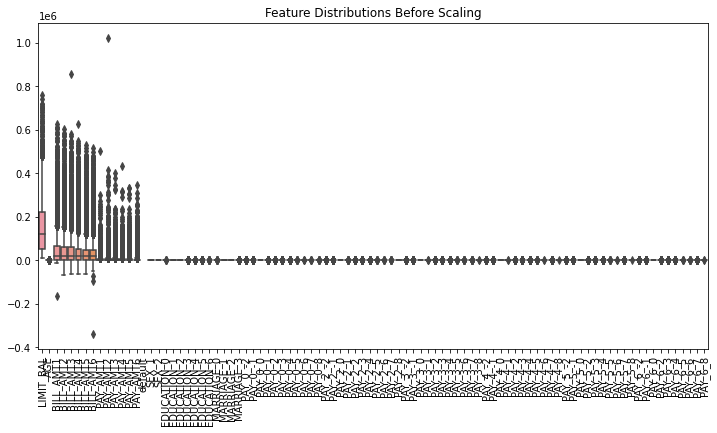

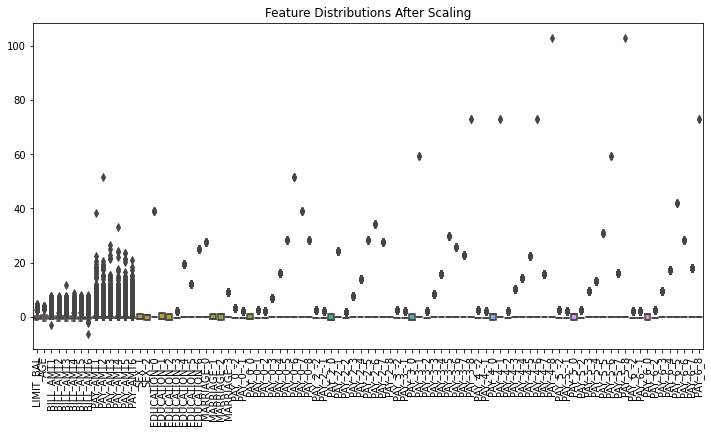

In [31]:
X_train_downsampled, X_test_downsampled = scale_the_features(X_train_downsampled, X_test_downsampled, df_downsampled)

## Basic Additional Data Exploration (Training Data)

In [32]:
# Train model Stats
print("Number of Features:", X_train_downsampled.shape[1])
print("Number Continuous Features:", X_train_downsampled.shape[1] - len(cat_cols))
print("Number Categorical Features:", len(cat_cols))
print("Number Train Examples:", X_train_downsampled.shape[0])
print("Number Positive Train Examples:", (y_train_downsampled == 1).sum())
print("Number Negative Train Examples:", (y_train_downsampled == 0).sum())

Number of Features: 91
Number Continuous Features: 82
Number Categorical Features: 9
Number Train Examples: 10617
Number Positive Train Examples: 5291
Number Negative Train Examples: 5326


# Build Model

## Set Up Hyperparameters

In [33]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam

In [34]:
# Building the model
model = models.Sequential([
    layers.Dense(64, activation='relu', input_shape=(X_train_downsampled.shape[1],)),
    layers.Dropout(0.5),
    layers.Dense(64, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(1, activation='sigmoid')
])

In [35]:
# Compiling the model
model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['accuracy'])

## Build Neural Network (w/TensorFlow/Keras)

In [36]:
# Training the model
history = model.fit(X_train_downsampled, y_train_downsampled, epochs=15, batch_size=32, validation_split=0.2, verbose=1)
print("Model trained successfully!")

Epoch 1/15
266/266 [==============================] - 1s 3ms/step - loss: 0.6969 - accuracy: 0.6063 - val_loss: 0.5954 - val_accuracy: 0.7006
Epoch 2/15
266/266 [==============================] - 1s 2ms/step - loss: 0.6236 - accuracy: 0.6682 - val_loss: 0.5806 - val_accuracy: 0.7039
Epoch 3/15
266/266 [==============================] - 0s 2ms/step - loss: 0.6077 - accuracy: 0.6839 - val_loss: 0.5752 - val_accuracy: 0.7062
Epoch 4/15
266/266 [==============================] - 0s 2ms/step - loss: 0.5991 - accuracy: 0.6913 - val_loss: 0.5731 - val_accuracy: 0.7086
Epoch 5/15
266/266 [==============================] - 0s 2ms/step - loss: 0.5945 - accuracy: 0.6930 - val_loss: 0.5738 - val_accuracy: 0.7100
Epoch 6/15
266/266 [==============================] - 0s 2ms/step - loss: 0.5862 - accuracy: 0.6989 - val_loss: 0.5700 - val_accuracy: 0.7081
Epoch 7/15
266/266 [==============================] - 0s 2ms/step - loss: 0.5852 - accuracy: 0.7020 - val_loss: 0.5720 - val_accuracy: 0.7034
Epoch 

# Evaluate Model

## Assess and Display Model Peformance

### Tabular Data

In [37]:
y_pred_funct = display_model_metrics_tabular(model, X_test_downsampled, y_test_downsampled)

83/83 [==============================] - 0s 1ms/step - loss: 0.5663 - accuracy: 0.7032


83/83 [==============================] - 0s 975us/step


Metric,Value
Accuracy,0.703202
ROC AUC Score,0.782686
Precision (Class 0),0.662516
Recall (Class 0),0.812214
F1-Score (Class 0),0.729767
Precision (Class 1),0.765491
Recall (Class 1),0.597026
F1-Score (Class 1),0.670844


Tablular Done!


### Confusion Matrix

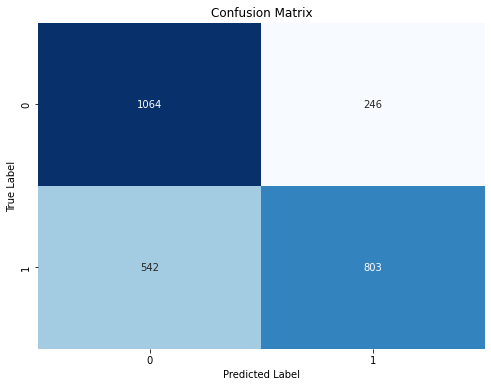

'Confusion Matrix!'

In [38]:
generate_confusion_matrix(y_test_downsampled, y_pred_funct)

# Generate ANCHOR Values

#### Suppress Warnings to clean up output

In [39]:
import warnings
warnings.simplefilter(action='ignore', category=Warning)

Check layout of X_train_downsampled

In [40]:
X_train_downsampled

array([[ 0.05089392,  0.88933756, -0.6860735 , ..., -0.0350136 ,
        -0.05583828, -0.01372635],
       [ 0.60622866,  0.25302049, -0.48513769, ..., -0.0350136 ,
        -0.05583828, -0.01372635],
       [-0.98044203,  0.35907334, -0.55266519, ..., -0.0350136 ,
        -0.05583828, -0.01372635],
       ...,
       [ 1.63756461,  1.52565463, -0.6860735 , ..., -0.0350136 ,
        -0.05583828, -0.01372635],
       [-0.9011085 ,  1.84381317, -0.49459937, ..., -0.0350136 ,
        -0.05583828, -0.01372635],
       [-0.02843962, -0.17119089, -0.64424506, ..., -0.0350136 ,
        -0.05583828, -0.01372635]])

In [41]:
# Extract the feature names, excluding the target variable 'default'
column_names = df_downsampled.drop('default', axis=1).columns

In [42]:
# Convert NumPy array to DataFrame
X_train_downsampled = pd.DataFrame(X_train_downsampled, columns=column_names)

In [43]:
X_train_downsampled.head()

,LIMIT_BAL,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,SEX_1,SEX_2,EDUCATION_0,EDUCATION_1,EDUCATION_2,EDUCATION_3,EDUCATION_4,EDUCATION_5,EDUCATION_6,MARRIAGE_0,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3,PAY_0_-2,PAY_0_-1,PAY_0_0,PAY_0_1,PAY_0_2,PAY_0_3,PAY_0_4,PAY_0_5,PAY_0_6,PAY_0_7,PAY_0_8,PAY_2_-2,PAY_2_-1,PAY_2_0,PAY_2_1,PAY_2_2,PAY_2_3,PAY_2_4,PAY_2_5,PAY_2_6,PAY_2_7,PAY_2_8,PAY_3_-2,PAY_3_-1,PAY_3_0,PAY_3_1,PAY_3_2,PAY_3_3,PAY_3_4,PAY_3_5,PAY_3_6,PAY_3_7,PAY_3_8,PAY_4_-2,PAY_4_-1,PAY_4_0,PAY_4_1,PAY_4_2,PAY_4_3,PAY_4_4,PAY_4_5,PAY_4_6,PAY_4_7,PAY_4_8,PAY_5_-2,PAY_5_-1,PAY_5_0,PAY_5_2,PAY_5_3,PAY_5_4,PAY_5_5,PAY_5_6,PAY_5_7,PAY_5_8,PAY_6_-2,PAY_6_-1,PAY_6_0,PAY_6_2,PAY_6_3,PAY_6_4,PAY_6_5,PAY_6_6,PAY_6_7,PAY_6_8
0,0.050894,0.889338,-0.686074,-0.486984,-0.676383,-0.668875,-0.658723,-0.648698,0.722404,-0.259136,-0.301054,-0.315455,-0.295527,-0.234418,-0.840944,0.840944,-0.025686,-0.710106,-0.957482,2.173350,-0.051422,-0.083207,-0.040047,-0.036337,1.076478,-1.048356,-0.109591,-0.294816,-0.451377,-0.847818,2.392462,-0.430653,-0.143426,-0.061496,-0.035014,-0.019414,-0.025686,-0.035014,-0.367454,2.143311,-0.945265,-0.04121,-0.504940,-0.132066,-0.070831,-0.035014,-0.029128,-0.036337,0.0,-0.384104,2.194888,-0.973140,-0.016812,-0.485621,-0.116014,-0.06377,-0.033638,-0.03885,-0.043443,-0.013726,2.476909,-0.439533,-1.039687,-0.013726,-0.43311,-0.096522,-0.070156,-0.044518,-0.013726,-0.063021,-0.009706,2.385368,-0.438007,-1.076274,-0.388612,-0.104644,-0.074754,-0.032205,-0.016812,-0.062263,-0.009706,-0.43357,2.191988,-1.031094,-0.395487,-0.102788,-0.058329,-0.023779,-0.035014,-0.055838,-0.013726
1,0.606229,0.253020,-0.485138,-0.352338,0.081269,0.886345,1.036743,1.862763,0.407355,1.261717,3.051064,0.047119,3.289522,-0.038190,-0.840944,0.840944,-0.025686,-0.710106,-0.957482,2.173350,-0.051422,-0.083207,-0.040047,-0.036337,-0.928956,0.953874,-0.109591,-0.294816,-0.451377,1.179498,-0.417979,-0.430653,-0.143426,-0.061496,-0.035014,-0.019414,-0.025686,-0.035014,-0.367454,-0.466568,1.057904,-0.04121,-0.504940,-0.132066,-0.070831,-0.035014,-0.029128,-0.036337,0.0,-0.384104,-0.455604,1.027601,-0.016812,-0.485621,-0.116014,-0.06377,-0.033638,-0.03885,-0.043443,-0.013726,-0.403729,-0.439533,0.961828,-0.013726,-0.43311,-0.096522,-0.070156,-0.044518,-0.013726,-0.063021,-0.009706,-0.419223,-0.438007,0.929132,-0.388612,-0.104644,-0.074754,-0.032205,-0.016812,-0.062263,-0.009706,-0.43357,-0.456207,0.969843,-0.395487,-0.102788,-0.058329,-0.023779,-0.035014,-0.055838,-0.013726
2,-0.980442,0.359073,-0.552665,-0.550393,-0.528039,-0.506867,-0.472906,-0.467007,-0.357144,-0.198302,-0.275913,-0.238163,-0.306315,-0.221580,-0.840944,0.840944,-0.025686,-0.710106,1.044406,-0.460119,-0.051422,-0.083207,-0.040047,-0.036337,1.076478,-1.048356,-0.109591,-0.294816,-0.451377,-0.847818,-0.417979,2.322054,-0.143426,-0.061496,-0.035014,-0.019414,-0.025686,-0.035014,-0.367454,-0.466568,-0.945265,-0.04121,1.980433,-0.132066,-0.070831,-0.035014,-0.029128,-0.036337,0.0,-0.384104,-0.455604,1.027601,-0.016812,-0.485621,-0.116014,-0.06377,-0.033638,-0.03885,-0.043443,-0.013726,-0.403729,-0.439533,0.961828,-0.013726,-0.43311,-0.096522,-0.070156,-0.044518,-0.013726,-0.063021,-0.009706,-0.419223,-0.438007,0.929132,-0.388612,-0.104644,-0.074754,-0.032205,-0.016812,-0.062263,-0.009706,-0.43357,-0.456207,-1.031094,2.528528,-0.102788,-0.058329,-0.023779,-0.035014,-0.055838,-0.013726
3,0.368228,-0.913561,-0.637591,-0.633781,-0.561509,-0.508868,-0.543475,-0.556081,-0.080243,0.145918,0.101200,-0.315455,-0.162481,0.022940,1.189139,-1.189139,-0.025686,1.408241,-0.957482,-0.460119,-0.051422,-0.083207,-0.040047,-0.036337,-0.928956,0.953874,-0.109591,-0.294816,2.215441,-0.847818,-0.417979,-0.430653,-0.143426,-0.061496,-0.035014,-0.019414,-0.025686,-0.035014,-0.367454,2.143311,-0.945265,-0.04121,-0.504940,-0.132066,-0.070831,-0.035014,-0.029128,-0.036337,0.0,-0.384104,2.194888,-0.973140,-0.016812,-0.485621,-0.116014,-0.06377,-0

In [44]:
from anchor import anchor_tabular
import numpy as np

In [45]:
# Separate the features and the target variable
X = df_encoded.drop('default', axis=1)
y = df_encoded['default']

In [46]:
# Define the explainer
explainer = anchor_tabular.AnchorTabularExplainer(
    class_names=['Not Default', 'Default'],
    feature_names=X.columns.tolist(),
    train_data=X_train_downsampled.values,
    categorical_names={}
)

In [47]:
import contextlib
import numpy as np
import os
import sys
from contextlib import contextmanager

In [48]:
@contextmanager
def suppress_stdout():
    with open(os.devnull, 'w') as fnull:
        with contextlib.redirect_stdout(fnull), contextlib.redirect_stderr(fnull):
            yield None

In [51]:
def predict_fn(x):
    # Ensure x is in batch format
    if len(x.shape) == 1:
        x = np.expand_dims(x, axis=0)
    # Suppress the output of the progress bar
    with suppress_stdout():
        # Get the model's prediction (probability of the positive class)
        probabilities = model.predict(x, verbose=0)
    # Convert probabilities to class labels (0 or 1)
    labels = (probabilities > 0.5).astype(int)
    return labels.flatten()

In [52]:
# Convert NumPy array to DataFrame
X_test_downsampled = pd.DataFrame(X_test_downsampled, columns=column_names)

In [53]:
# Ensure that the instance passed to explain_instance is in the correct shape
idx = 0
instance_to_explain = X_test_downsampled.iloc[idx].values.reshape(1, -1)

In [54]:
# Generate an explanation for the first instance in the test set
exp = explainer.explain_instance(instance_to_explain, predict_fn, threshold=0.95)

In [55]:
# Show the explanation
exp.show_in_notebook()

In [56]:
exp.show_in_notebook(show_table=True, show_all=False)

#### ChatGPT Prompt to Generate Initial ANCHOR Values

For the RF model built above in Python, select a random sample 
of 15 instances in the test data, 10 for Class '0' and 5 for 
Class '1', and generate ANCHOR values as explainers for these  
instances in the test dataset.

Present these ANCHOR values in an easily understood and pleasant 
on the eye tabular output format for the Python Kubeflow Notebook
in which I am writing my Python code. 

Create a second tabular format what shows an equally appealing 
output in my Python Notebook that shows the ANCHOR values and the
feature details for each instance on a single row, across which I
can scroll.

Comment each line of Python code with as much detail as practical. 

Output the ANCHOR values to a CSV file. Output the feature details 
for each corresponding instance for which the ANCHOR Values were
created in a seperate CSV file.

After the code generation provide as much narrative detail 
as possible.

##### ChatGPT Preamble

Certainly! To fulfill your request, we'll use the AnchorTabular explainer from the alibi library. This explainer provides local explanations for classification models' predictions by identifying a minimal set of conditions (features) in the instance that ensure the model's decision remains unchanged (these conditions are called "anchors").

The steps we'll follow are:

Select a random sample of 15 instances from the test data, 10 from Class '0' and 5 from Class '1'.
Set up the AnchorTabular explainer and fit it to the training data.
Generate anchor explanations for the selected instances.
Present the anchor values in two tabular formats: a summary table and a detailed table.
Output the anchor values and feature details to CSV files.

In [57]:
# Loop through the first five instances in the test dataset
for idx in range(5):
    instance = X_test_downsampled.iloc[idx].values.reshape(1, -1)
    print(f"\nInstance {idx + 1}:")
    
    # Generate an explanation for the instance
    exp = explainer.explain_instance(instance, predict_fn, threshold=0.95)
    
    # Show the explanation in the notebook
    exp.show_in_notebook()


Instance 1:



Instance 2:



Instance 3:



Instance 4:



Instance 5:


### Create an ANCHOR File Output

In [58]:
# Initialize a list to store the ANCHOR results
anchor_results = []

In [59]:
import re

anchor_results = []

# Loop through the first five instances in the test dataset
for idx in range(5):
    instance = X_test_downsampled.iloc[idx].values.reshape(1, -1)
    # Generate an explanation for the instance
    exp = explainer.explain_instance(instance, predict_fn, threshold=0.95)
    
    # Extract feature importance from the explanation
    feature_importance = {}
    for condition in exp.names():
        # Handle conditions with '='
        if '=' in condition:
            feature, value = condition.split('=')
            feature = feature.strip()
            value = float(value.strip())
            feature_importance[feature] = ('=', value)
        # Handle conditions with '>' or '<'
        elif '>' in condition or '<' in condition:
            parts = re.split('([><])', condition)
            feature, operator, value = [part.strip() for part in parts if part.strip()]
            value = float(value)
            feature_importance[feature] = (operator, value)
        else:
            raise ValueError(f"Unexpected format for ANCHOR explanation: {condition}")

    anchor_results.append(feature_importance)

In [60]:
# Create a DataFrame from the results
df_anchor_results = pd.DataFrame(anchor_results)

In [61]:
# Show the DataFrame
print(df_anchor_results)

     PAY_0_-2    PAY_2_-2    PAY_AMT1     PAY_0_0    PAY_6_-1    PAY_AMT2  \
0  (>, -0.29)  (>, -0.37)   (>, -0.2)         NaN         NaN         NaN   
1         NaN         NaN         NaN  (>, -0.85)  (>, -0.46)  (>, -0.16)   
2         NaN         NaN         NaN         NaN         NaN         NaN   
3         NaN         NaN         NaN  (>, -0.85)         NaN         NaN   
4         NaN         NaN  (>, -0.33)  (>, -0.85)         NaN         NaN   

      PAY_0_2 LIMIT_BAL <     PAY_2_0   PAY_0_2 <   LIMIT_BAL    PAY_5_-1  
0         NaN         NaN         NaN         NaN         NaN         NaN  
1         NaN         NaN         NaN         NaN         NaN         NaN  
2  (>, -0.43)  (=, -0.82)         NaN         NaN         NaN         NaN  
3         NaN         NaN  (>, -0.95)  (=, -0.43)  (>, -0.27)         NaN  
4         NaN         NaN         NaN         NaN         NaN  (>, -0.44)  


In [62]:
# Write the DataFrame to a CSV file
df_anchor_results.to_csv('anchor_results_ANN.csv', index=False)

-----

# Prepare ANCHOR Values for Metrics

In [63]:
# Initialize a list to store the ANCHOR results
new_anchor_results = []
feature_instances = []

# Loop through the first five instances in the test dataset
for idx in range(5):
    instance = X_test_downsampled.iloc[idx]
    feature_instances.append(instance)
    
    # Generate an explanation for the instance with a lower threshold
    exp = explainer.explain_instance(instance.values.reshape(1, -1), predict_fn, threshold=0.99)
    
    # Check if an explanation was found
    if exp is not None:
        # Parse the conditions from the explanation and format them
        anchor_explanation = []
        for condition in exp.names():
            if ' > ' in condition or ' < ' in condition:
                feature, relation, value = condition.split(' ')[0], condition.split(' ')[1], condition.split(' ')[2]
                try:
                    anchor_explanation.append(f"'{feature} {relation} {float(value):.2f}'")
                except ValueError:
                    anchor_explanation.append(f"'{condition}'")
            else:
                anchor_explanation.append(f"'{condition}'")

        # Convert the list of strings to a single string
        anchor_explanation_str = '[' + ', '.join(anchor_explanation) + ']'

        # Add the formatted explanation to the results list
        new_anchor_results.append(anchor_explanation_str)
    else:
        new_anchor_results.append("['No explanation found']")

# Create a DataFrame from the results
new_df_anchor_results = pd.DataFrame(new_anchor_results, columns=['Anchor Explanation'])

# Create a DataFrame from the feature instances
df_feature_instances = pd.DataFrame(feature_instances)

# Show the DataFrames
print("Anchor Explanations:")
print(new_df_anchor_results)
#print("\nFeature Instances:")
#print(df_feature_instances)

# Write the DataFrames to CSV files
new_df_anchor_results.to_csv('new_anchor_results5.csv', index=False)
df_feature_instances.to_csv('feature_instances5.csv', index=False)


Anchor Explanations:
                                  Anchor Explanation
0  ['PAY_0_-2 > -0.29', 'PAY_2_-2 > -0.37', 'PAY_...
1  ['LIMIT_BAL > 0.53', 'PAY_0_0 > -0.85', 'PAY_6...
2          ['PAY_0_2 > -0.43', 'LIMIT_BAL <= -0.27']
3  ['PAY_0_0 > -0.85', 'PAY_2_0 > -0.95', 'PAY_0_...
4  ['PAY_0_2 <= -0.43', 'PAY_0_0 > -0.85', 'PAY_5...


In [64]:
df_feature_instances.head()

,LIMIT_BAL,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,SEX_1,SEX_2,EDUCATION_0,EDUCATION_1,EDUCATION_2,EDUCATION_3,EDUCATION_4,EDUCATION_5,EDUCATION_6,MARRIAGE_0,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3,PAY_0_-2,PAY_0_-1,PAY_0_0,PAY_0_1,PAY_0_2,PAY_0_3,PAY_0_4,PAY_0_5,PAY_0_6,PAY_0_7,PAY_0_8,PAY_2_-2,PAY_2_-1,PAY_2_0,PAY_2_1,PAY_2_2,PAY_2_3,PAY_2_4,PAY_2_5,PAY_2_6,PAY_2_7,PAY_2_8,PAY_3_-2,PAY_3_-1,PAY_3_0,PAY_3_1,PAY_3_2,PAY_3_3,PAY_3_4,PAY_3_5,PAY_3_6,PAY_3_7,PAY_3_8,PAY_4_-2,PAY_4_-1,PAY_4_0,PAY_4_1,PAY_4_2,PAY_4_3,PAY_4_4,PAY_4_5,PAY_4_6,PAY_4_7,PAY_4_8,PAY_5_-2,PAY_5_-1,PAY_5_0,PAY_5_2,PAY_5_3,PAY_5_4,PAY_5_5,PAY_5_6,PAY_5_7,PAY_5_8,PAY_6_-2,PAY_6_-1,PAY_6_0,PAY_6_2,PAY_6_3,PAY_6_4,PAY_6_5,PAY_6_6,PAY_6_7,PAY_6_8
0,0.368228,-0.913561,-0.628615,-0.632830,-0.612261,-0.619758,-0.572999,-0.635329,-0.075044,-0.033036,-0.087189,0.089397,-0.237994,-0.267428,-0.840944,0.840944,-0.025686,1.408241,-0.957482,-0.460119,-0.051422,-0.083207,-0.040047,-0.036337,-0.928956,0.953874,-0.109591,3.391946,-0.451377,-0.847818,-0.417979,-0.430653,-0.143426,-0.061496,-0.035014,-0.019414,-0.025686,-0.035014,2.721429,-0.466568,-0.945265,-0.04121,-0.504940,-0.132066,-0.070831,-0.035014,-0.029128,-0.036337,0.0,2.603463,-0.455604,-0.973140,-0.016812,-0.485621,-0.116014,-0.06377,-0.033638,-0.03885,-0.043443,-0.013726,2.476909,-0.439533,-1.039687,-0.013726,-0.433110,-0.096522,-0.070156,-0.044518,-0.013726,-0.063021,-0.009706,2.385368,-0.438007,-1.076274,-0.388612,-0.104644,-0.074754,-0.032205,-0.016812,-0.062263,-0.009706,2.306435,-0.456207,-1.031094,-0.395487,-0.102788,-0.058329,-0.023779,-0.035014,-0.055838,-0.013726
1,2.668901,-0.595402,-0.333953,-0.347570,-0.324313,-0.407201,-0.683714,0.393137,-0.204015,-0.155668,-0.227844,-0.315145,4.360721,-0.099137,-0.840944,0.840944,-0.025686,-0.710106,1.044406,-0.460119,-0.051422,-0.083207,-0.040047,-0.036337,1.076478,-1.048356,-0.109591,-0.294816,-0.451377,1.179498,-0.417979,-0.430653,-0.143426,-0.061496,-0.035014,-0.019414,-0.025686,-0.035014,-0.367454,-0.466568,1.057904,-0.04121,-0.504940,-0.132066,-0.070831,-0.035014,-0.029128,-0.036337,0.0,-0.384104,-0.455604,1.027601,-0.016812,-0.485621,-0.116014,-0.06377,-0.033638,-0.03885,-0.043443,-0.013726,-0.403729,-0.439533,0.961828,-0.013726,-0.433110,-0.096522,-0.070156,-0.044518,-0.013726,-0.063021,-0.009706,-0.419223,-0.438007,0.929132,-0.388612,-0.104644,-0.074754,-0.032205,-0.016812,-0.062263,-0.009706,-0.433570,2.191988,-1.031094,-0.395487,-0.102788,-0.058329,-0.023779,-0.035014,-0.055838,-0.013726
2,-1.059776,-1.337772,-0.591052,-0.574008,-0.566800,-0.541171,-0.527535,-0.494414,-0.270908,-0.259136,-0.247420,-0.315455,-0.198440,-0.232890,1.189139,-1.189139,-0.025686,1.408241,-0.957482,-0.460119,-0.051422,-0.083207,-0.040047,-0.036337,-0.928956,0.953874,-0.109591,-0.294816,-0.451377,-0.847818,-0.417979,2.322054,-0.143426,-0.061496,-0.035014,-0.019414,-0.025686,-0.035014,-0.367454,-0.466568,-0.945265,-0.04121,1.980433,-0.132066,-0.070831,-0.035014,-0.029128,-0.036337,0.0,-0.384104,-0.455604,-0.973140,-0.016812,2.059217,-0.116014,-0.06377,-0.033638,-0.03885,-0.043443,-0.013726,-0.403729,-0.439533,-1.039687,-0.013726,2.308885,-0.096522,-0.070156,-0.044518,-0.013726,-0.063021,-0.009706,-0.419223,-0.438007,-1.076274,2.573262,-0.104644,-0.074754,-0.032205,-0.016812,-0.062263,-0.009706,-0.433570,-0.456207,-1.031094,2.528528,-0.102788,-0.058329,-0.023779,-0.035014,-0.055838,-0.013726
3,0.050894,-0.489349,0.000958,0.068631,0.126069,0.250735,0.349657,0.450760,-0.051344,-0.107051,0.034158,-0.083581,0.053269,-0.160450,1.189139,-1.189139,-0.025686,-0.710106,-0.957482,2.173350,-0.051422,-0.083207,-0.040047,-0.036337,-0.928956,0.953874,-0.109591,-0.294816,-0.451377,1.179498,-0.417979,-0.430653,-0.143426,-0.061496,-0.035014,-0.019414,-0.025686,-0.035014,-0.367454,-0.466568,1.057904,-0.04121,-0.504940,-0.132066,-0.070831,-0.035014,-0.029128,-0.036337,0.0,-0.384104,-0.455604,1.027601,-0.016812,-0.485621,-0.116014,

In [65]:
new_df_anchor_results

,Anchor Explanation
0,"['PAY_0_-2 > -0.29', 'PAY_2_-2 > -0.37', 'PAY_..."
1,"['LIMIT_BAL > 0.53', 'PAY_0_0 > -0.85', 'PAY_6..."
2,"['PAY_0_2 > -0.43', 'LIMIT_BAL <= -0.27']"
3,"['PAY_0_0 > -0.85', 'PAY_2_0 > -0.95', 'PAY_0_..."
4,"['PAY_0_2 <= -0.43', 'PAY_0_0 > -0.85', 'PAY_5..."


## Parse the Anchor Explanations

In [66]:
import pandas as pd
import ast


# Step 2: Convert the 'Anchor Explanation' column from a string representation of a list back to an actual list
new_df_anchor_results['Anchor Explanation'] = new_df_anchor_results['Anchor Explanation'].apply(ast.literal_eval)

# Step 3: Determine the maximum number of conditions in the ANCHOR explanations across all instances
max_num_conditions = max(new_df_anchor_results['Anchor Explanation'].apply(len))

# Step 4: Initialize a list to store the numerical representations of the ANCHOR explanations
numerical_explanations = []

# Step 5: Loop through each ANCHOR explanation and convert it to a numerical representation
for explanation in new_df_anchor_results['Anchor Explanation']:
    numerical_representation = [-1] * len(df_feature_instances.columns) * max_num_conditions
    for idx, condition in enumerate(explanation):
        # Parse the condition to extract the feature name and value
        feature, relation, value = condition.split(' ')[0], condition.split(' ')[1], condition.split(' ')[2]
        
        # Find the index of the feature in the feature dataframe
        feature_idx = df_feature_instances.columns.get_loc(feature)
        
        # Store the feature index in the numerical representation
        numerical_representation[feature_idx * max_num_conditions + idx] = float(value)
    numerical_explanations.append(numerical_representation)

# Step 6: Create a dataframe from the numerical representations
df_anchors_numerical = pd.DataFrame(numerical_explanations)

# Display the resulting dataframe
print(df_anchors_numerical)


    0     1    2    3     4    5    6    7    8    9    10   11   12   13   \
0 -1.00 -1.00   -1   -1 -1.00   -1   -1   -1   -1   -1   -1   -1   -1   -1   
1  0.53 -1.00   -1   -1 -1.00   -1   -1   -1   -1   -1   -1   -1   -1   -1   
2 -1.00 -0.27   -1   -1 -1.00   -1   -1   -1   -1   -1   -1   -1   -1   -1   
3 -1.00 -1.00   -1   -1 -0.27   -1   -1   -1   -1   -1   -1   -1   -1   -1   
4 -1.00 -1.00   -1   -1 -1.00   -1   -1   -1   -1   -1   -1   -1   -1   -1   

   14   15   16   17   18   19   20   21   22   23   24   25   26   27   28   \
0   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   
1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   
2   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   
3   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   
4   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   -1   

   29   30   31   32   33   34   35   36   37   38

In [67]:
new_df_anchor_results

,Anchor Explanation
0,"[PAY_0_-2 > -0.29, PAY_2_-2 > -0.37, PAY_AMT1 ..."
1,"[LIMIT_BAL > 0.53, PAY_0_0 > -0.85, PAY_6_-1 >..."
2,"[PAY_0_2 > -0.43, LIMIT_BAL <= -0.27]"
3,"[PAY_0_0 > -0.85, PAY_2_0 > -0.95, PAY_0_2 <= ..."
4,"[PAY_0_2 <= -0.43, PAY_0_0 > -0.85, PAY_5_-1 >..."


## Display ANCHORS

In [68]:
# Display the first few rows of each dataset to understand their structure
instance_features_head = df_feature_instances.head()
anchor_explanations_head = new_df_anchor_results.head()
anchor_explanations_numerical = df_anchors_numerical.head()

In [69]:
instance_features_head

,LIMIT_BAL,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,SEX_1,SEX_2,EDUCATION_0,EDUCATION_1,EDUCATION_2,EDUCATION_3,EDUCATION_4,EDUCATION_5,EDUCATION_6,MARRIAGE_0,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3,PAY_0_-2,PAY_0_-1,PAY_0_0,PAY_0_1,PAY_0_2,PAY_0_3,PAY_0_4,PAY_0_5,PAY_0_6,PAY_0_7,PAY_0_8,PAY_2_-2,PAY_2_-1,PAY_2_0,PAY_2_1,PAY_2_2,PAY_2_3,PAY_2_4,PAY_2_5,PAY_2_6,PAY_2_7,PAY_2_8,PAY_3_-2,PAY_3_-1,PAY_3_0,PAY_3_1,PAY_3_2,PAY_3_3,PAY_3_4,PAY_3_5,PAY_3_6,PAY_3_7,PAY_3_8,PAY_4_-2,PAY_4_-1,PAY_4_0,PAY_4_1,PAY_4_2,PAY_4_3,PAY_4_4,PAY_4_5,PAY_4_6,PAY_4_7,PAY_4_8,PAY_5_-2,PAY_5_-1,PAY_5_0,PAY_5_2,PAY_5_3,PAY_5_4,PAY_5_5,PAY_5_6,PAY_5_7,PAY_5_8,PAY_6_-2,PAY_6_-1,PAY_6_0,PAY_6_2,PAY_6_3,PAY_6_4,PAY_6_5,PAY_6_6,PAY_6_7,PAY_6_8
0,0.368228,-0.913561,-0.628615,-0.632830,-0.612261,-0.619758,-0.572999,-0.635329,-0.075044,-0.033036,-0.087189,0.089397,-0.237994,-0.267428,-0.840944,0.840944,-0.025686,1.408241,-0.957482,-0.460119,-0.051422,-0.083207,-0.040047,-0.036337,-0.928956,0.953874,-0.109591,3.391946,-0.451377,-0.847818,-0.417979,-0.430653,-0.143426,-0.061496,-0.035014,-0.019414,-0.025686,-0.035014,2.721429,-0.466568,-0.945265,-0.04121,-0.504940,-0.132066,-0.070831,-0.035014,-0.029128,-0.036337,0.0,2.603463,-0.455604,-0.973140,-0.016812,-0.485621,-0.116014,-0.06377,-0.033638,-0.03885,-0.043443,-0.013726,2.476909,-0.439533,-1.039687,-0.013726,-0.433110,-0.096522,-0.070156,-0.044518,-0.013726,-0.063021,-0.009706,2.385368,-0.438007,-1.076274,-0.388612,-0.104644,-0.074754,-0.032205,-0.016812,-0.062263,-0.009706,2.306435,-0.456207,-1.031094,-0.395487,-0.102788,-0.058329,-0.023779,-0.035014,-0.055838,-0.013726
1,2.668901,-0.595402,-0.333953,-0.347570,-0.324313,-0.407201,-0.683714,0.393137,-0.204015,-0.155668,-0.227844,-0.315145,4.360721,-0.099137,-0.840944,0.840944,-0.025686,-0.710106,1.044406,-0.460119,-0.051422,-0.083207,-0.040047,-0.036337,1.076478,-1.048356,-0.109591,-0.294816,-0.451377,1.179498,-0.417979,-0.430653,-0.143426,-0.061496,-0.035014,-0.019414,-0.025686,-0.035014,-0.367454,-0.466568,1.057904,-0.04121,-0.504940,-0.132066,-0.070831,-0.035014,-0.029128,-0.036337,0.0,-0.384104,-0.455604,1.027601,-0.016812,-0.485621,-0.116014,-0.06377,-0.033638,-0.03885,-0.043443,-0.013726,-0.403729,-0.439533,0.961828,-0.013726,-0.433110,-0.096522,-0.070156,-0.044518,-0.013726,-0.063021,-0.009706,-0.419223,-0.438007,0.929132,-0.388612,-0.104644,-0.074754,-0.032205,-0.016812,-0.062263,-0.009706,-0.433570,2.191988,-1.031094,-0.395487,-0.102788,-0.058329,-0.023779,-0.035014,-0.055838,-0.013726
2,-1.059776,-1.337772,-0.591052,-0.574008,-0.566800,-0.541171,-0.527535,-0.494414,-0.270908,-0.259136,-0.247420,-0.315455,-0.198440,-0.232890,1.189139,-1.189139,-0.025686,1.408241,-0.957482,-0.460119,-0.051422,-0.083207,-0.040047,-0.036337,-0.928956,0.953874,-0.109591,-0.294816,-0.451377,-0.847818,-0.417979,2.322054,-0.143426,-0.061496,-0.035014,-0.019414,-0.025686,-0.035014,-0.367454,-0.466568,-0.945265,-0.04121,1.980433,-0.132066,-0.070831,-0.035014,-0.029128,-0.036337,0.0,-0.384104,-0.455604,-0.973140,-0.016812,2.059217,-0.116014,-0.06377,-0.033638,-0.03885,-0.043443,-0.013726,-0.403729,-0.439533,-1.039687,-0.013726,2.308885,-0.096522,-0.070156,-0.044518,-0.013726,-0.063021,-0.009706,-0.419223,-0.438007,-1.076274,2.573262,-0.104644,-0.074754,-0.032205,-0.016812,-0.062263,-0.009706,-0.433570,-0.456207,-1.031094,2.528528,-0.102788,-0.058329,-0.023779,-0.035014,-0.055838,-0.013726
3,0.050894,-0.489349,0.000958,0.068631,0.126069,0.250735,0.349657,0.450760,-0.051344,-0.107051,0.034158,-0.083581,0.053269,-0.160450,1.189139,-1.189139,-0.025686,-0.710106,-0.957482,2.173350,-0.051422,-0.083207,-0.040047,-0.036337,-0.928956,0.953874,-0.109591,-0.294816,-0.451377,1.179498,-0.417979,-0.430653,-0.143426,-0.061496,-0.035014,-0.019414,-0.025686,-0.035014,-0.367454,-0.466568,1.057904,-0.04121,-0.504940,-0.132066,-0.070831,-0.035014,-0.029128,-0.036337,0.0,-0.384104,-0.455604,1.027601,-0.016812,-0.485621,-0.116014,

In [70]:
anchor_explanations_head

,Anchor Explanation
0,"[PAY_0_-2 > -0.29, PAY_2_-2 > -0.37, PAY_AMT1 ..."
1,"[LIMIT_BAL > 0.53, PAY_0_0 > -0.85, PAY_6_-1 >..."
2,"[PAY_0_2 > -0.43, LIMIT_BAL <= -0.27]"
3,"[PAY_0_0 > -0.85, PAY_2_0 > -0.95, PAY_0_2 <= ..."
4,"[PAY_0_2 <= -0.43, PAY_0_0 > -0.85, PAY_5_-1 >..."


In [71]:
anchor_explanations_numerical

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454
0,-1.00,-1.00,-1,-1,-1.00,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-0.2,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-0.29,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1.00,-1.00,-1,-1,-1,-1,-1,-1,-1,-1,-1.00,-1,-1.00,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-0.37,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1.00,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1.00,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1.00,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1.00,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
1,0.53,-1.00,-1,-1,-1.00,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1.0,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1.00,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1.00,-0.85,-1,-1,-1,-1,-1,-1,-1,-1,-1.00,-1,-1.00,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1.00,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1.00,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1

## Generate Outfile for review

In [72]:
anchors_num_explainers_filepath = "anchor_numerical_explainers.csv"

anchor_explanations_numerical.to_csv(anchors_num_explainers_filepath, index=False)

# Generate XAI Metrics 

## Identity Metric 

#### Run a Basic Test First

In [73]:
# Select two random instances from the ANCHOR dataframe
df_xai_numerical = anchor_explanations_numerical

random_indices = np.random.choice(df_xai_numerical.index, size=2, replace=False)
instance_1 = df_xai_numerical.iloc[random_indices[0]]
instance_2 = df_xai_numerical.iloc[random_indices[1]]

# Compute the Euclidean distance between the selected instances - uses custom project function
distance = get_euclidean_distance(instance_1, instance_2)
print(f"Euclidean distance between instance {random_indices[0]} and instance {random_indices[1]}: {distance:.4f}")


Calculating Euclidean distance...


Euclidean distance between instance 3 and instance 2: 1.3199


#### Retrieve Identity Score

In [74]:
from scipy.spatial import distance

In [75]:
ANCHOR_Identity_Metric = get_identity_metric(df_feature_instances, anchor_explanations_numerical, "ANCHOR")

Instance 0:   Current matches: 1
	Closest feature instance: 4 (Distance: 9.4113)
	Closest ANCHOR instance: {closest_xai_idx} (Distance: {xai_distances[closest_xai_idx]:.4f})
Instance 1:   Current matches: 2
	Closest feature instance: 4 (Distance: 7.9473)
	Closest ANCHOR instance: {closest_xai_idx} (Distance: {xai_distances[closest_xai_idx]:.4f})
Instance 2:   Current matches: 3
	Closest feature instance: 4 (Distance: 9.1626)
	Closest ANCHOR instance: {closest_xai_idx} (Distance: {xai_distances[closest_xai_idx]:.4f})
Instance 3:   Current matches: 4
	Closest feature instance: 4 (Distance: 6.9242)
	Closest ANCHOR instance: {closest_xai_idx} (Distance: {xai_distances[closest_xai_idx]:.4f})
Instance 4:   Current matches: 4
	Closest feature instance: 3 (Distance: 6.9242)
	Closest ANCHOR instance: {closest_xai_idx} (Distance: {xai_distances[closest_xai_idx]:.4f})


This is the function in XAI_METRICS_FUNCTIONS -- IDENTITY for ANCHOR



Percentage of matches: 80.00%   4 Matches of 5 Entries


#### Display Identity Score Metric

In [76]:
ANCHOR_Identity_Number = "{:.2f}%".format(ANCHOR_Identity_Metric)

In [77]:
display_text("ANCHOR Identity Metric Score: " + ANCHOR_Identity_Number)

## Stability Metric

### Invoke Stability Metric Function

In [78]:
ANCHOR_Stability_Metric = get_stability_metric_y(anchor_explanations_numerical, y_test_downsampled, 'ANCHOR')

Number of Instances in Cluster '0': 0
Number of Instances in Cluster '1': 0

For Class '0':
Total Instances: 2
Matching Cluster '0' Instances: 0

For Class '1':
Total Instances: 3
Matching Cluster '1' Instances: 0


This is the function in XAI_METRICS_FUNCTIONS -- STABILITY -- ANCHOR



Percentage of matches: 0.00%   0.0 Matches of 5 Entries


#### Display Stability Score Metric

In [79]:
ANCHOR_Stability_Number = "{:.2f}%".format(ANCHOR_Stability_Metric)

In [80]:
display_text("ANCHOR Stability Metric Score: " + ANCHOR_Stability_Number)

## Seperability

### Invoke Seperability Metric Function

#### Retrieve Seperability Score

In [81]:
ANCHOR_Seperability_Metric = get_seperability_metric(df_feature_instances, anchor_explanations_numerical, "ANCHOR")

Failure
Failure
Failure
Failure
Failure


#### Display Seperability Score Metric

In [82]:
ANCHOR_Seperability_Number = "{:.2f}%".format(ANCHOR_Seperability_Metric)

In [83]:
display_text("ANCHOR Seperability Metric Score: " + ANCHOR_Seperability_Number)

## Similarity

### Invoke Similarity Metric Function

#### Retrieve Similarity Score

In [84]:
ANCHOR_Similarity_Metric = get_similarity_metric(df_feature_instances, anchor_explanations_numerical, "ANCHOR", 
                                                 use_dbscan=False)

#### Display Similarity Score Metric

In [85]:
ANCHOR_Similarity_Number = "{:6.2f}".format(ANCHOR_Similarity_Metric)

In [86]:
display_text("ANCHOR Similarity Metric Value: " + ANCHOR_Similarity_Number)